In [195]:
#usual imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [196]:
#geopandas
import geopandas

In [197]:
#dataset
chipotle = pd.read_csv("../datasets/chipotle_stores.csv")

## First Contact

In [198]:
chipotle.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2629 entries, 0 to 2628
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   state      2629 non-null   object 
 1   location   2629 non-null   object 
 2   address    2629 non-null   object 
 3   latitude   2629 non-null   float64
 4   longitude  2629 non-null   float64
dtypes: float64(2), object(3)
memory usage: 102.8+ KB


In [199]:
chipotle.head()

,state,location,address,latitude,longitude
0,Alabama,Auburn,"346 W Magnolia Ave Auburn, AL 36832 US",32.606813,-85.487328
1,Alabama,Birmingham,"300 20th St S Birmingham, AL 35233 US",33.509721,-86.802756
2,Alabama,Birmingham,"3220 Morrow Rd Birmingham, AL 35235 US",33.595581,-86.647437
3,Alabama,Birmingham,"4719 Highway 280 Birmingham, AL 35242 US",33.422582,-86.698279
4,Alabama,Cullman,"1821 Cherokee Ave SW Cullman, AL 35055 US",34.154134,-86.841220


In [200]:
# Create a copy of the original DataFrame
chipotle_by_state = chipotle.copy()
# Add a new column and set the value to 1
chipotle_by_state['chipotle_count'] = 1

# use groupby() and count() to total up all the chipotle by state
chipotle_by_state = chipotle_by_state[['state',"chipotle_count"]].groupby('state').count()

# sort by most chipotle_count first
chipotle_by_state.sort_values('chipotle_count', ascending=False).head(10)

,chipotle_count
state,
California,421
Texas,226
Ohio,193
Florida,177
New York,160
Illinois,144
Virginia,107
Pennsylvania,96
Maryland,94


<AxesSubplot:ylabel='state'>

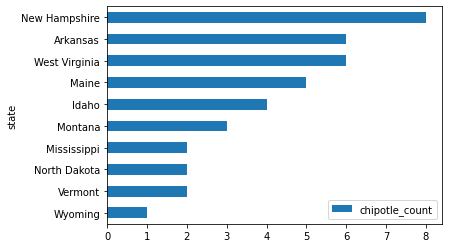

In [201]:
chipotle_by_state.sort_values('chipotle_count', ascending=True)[:10].plot(kind="barh") #States with the less chipotles

<AxesSubplot:ylabel='state'>

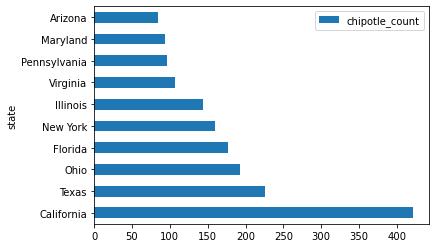

In [202]:
chipotle_by_state.sort_values('chipotle_count', ascending=False)[:10].plot.barh() #States with the most chipotles

<AxesSubplot:xlabel='longitude', ylabel='latitude'>

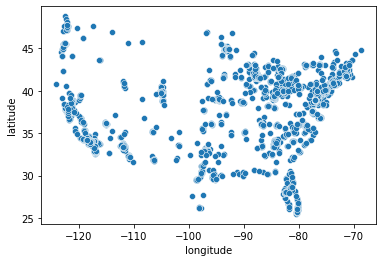

In [203]:
sns.scatterplot(data=chipotle,x="longitude",y="latitude")

## Shapefiles stuff

In [204]:
usa = geopandas.read_file('../shapefiles/2017_us_state/tl_2017_us_state.shp')

In [205]:
usa.head()

,REGION,DIVISION,STATEFP,STATENS,GEOID,STUSPS,NAME,LSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,3,5,54,01779805,54,WV,West Virginia,00,G4000,A,62265662566,489840834,+38.6472854,-080.6183274,"POLYGON ((-81.74725 39.09538, -81.74635 39.096..."
1,3,5,12,00294478,12,FL,Florida,00,G4000,A,138911437206,31398800291,+28.4574302,-082.4091478,"MULTIPOLYGON (((-82.98748 24.62538, -82.98748 ..."
2,2,3,17,01779784,17,IL,Illinois,00,G4000,A,143784114293,6211277447,+40.1028754,-089.1526108,"POLYGON ((-91.18529 40.63780, -91.17510 40.643..."
3,2,4,27,00662849,27,MN,Minnesota,00,G4000,A,206229176104,18944967530,+46.3158148,-094.1996628,"POLYGON ((-96.78438 46.63050, -96.78434 46.630..."
4,3,5,24,01714934,24,MD,Maryland,00,G4000,A,25150696145,6980371026,+38.9466584,-076.6744939,"POLYGON ((-77.45881 39.22027, -77.45866 39.220..."


In [206]:
usa.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands.  British Virgin Island

In [208]:
usa = usa.to_crs("EPSG:4326")

<AxesSubplot:>

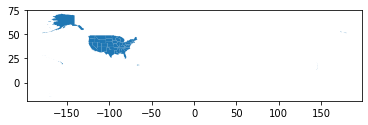

In [212]:
usa.plot()

In [213]:
gdf = geopandas.GeoDataFrame(
    chipotle, geometry=geopandas.points_from_xy(chipotle.longitude, chipotle.latitude))


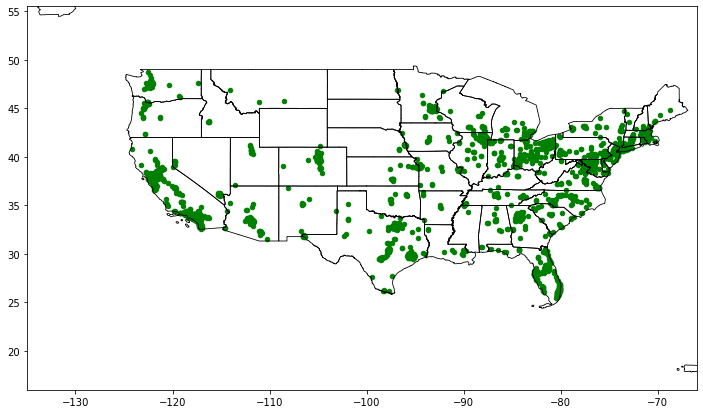

In [214]:
fig = plt.figure(1, figsize=(12,9)) 
ax = fig.add_subplot()

# US Lower 48 Bounding Box
# -141.00000, 26.00000, -65.50000, 72.00000

ax.set_xlim(-135, -66)
ax.set_ylim(16, 55.5)
usa.boundary.plot(ax=ax, color='black', linewidth=.8)
gdf.plot(ax=ax, color='green', markersize=20)


plt.show()


In [215]:
gdf[['longitude', 'latitude']]

,longitude,latitude
0,-85.487328,32.606813
1,-86.802756,33.509721
2,-86.647437,33.595581
3,-86.698279,33.422582
4,-86.841220,34.154134
...,...,...
2624,-87.921048,42.565892
2625,-88.048222,43.067723
2626,-96.796618,46.904247
2627,-96.861416,46.855337


## Create a X with LONG/LAT to be LAZIER

In [216]:
X = gdf[['longitude', 'latitude']]

In [217]:
import haversine as hs
from haversine import Unit

In [218]:
def get_distance_meters(p1,p2):
    return hs.haversine(p1,p2,unit=Unit.METERS)

## KMeans

In [312]:
from sklearn.cluster import KMeans

In [352]:
kmeans = KMeans(n_clusters=20, random_state=0).fit(X)

In [353]:
gdf['cluster_kmeans'] = kmeans.labels_

In [354]:
gdf.head()

,state,location,address,latitude,longitude,geometry,cluster_kmeans,distance_kmeans,cluster_DBSCAN,cluster_OPTICS
0,Alabama,Auburn,"346 W Magnolia Ave Auburn, AL 36832 US",32.606813,-85.487328,POINT (-85.48733 32.60681),17,158384.757561,0,-1
1,Alabama,Birmingham,"300 20th St S Birmingham, AL 35233 US",33.509721,-86.802756,POINT (-86.80276 33.50972),17,170569.733264,0,-1
2,Alabama,Birmingham,"3220 Morrow Rd Birmingham, AL 35235 US",33.595581,-86.647437,POINT (-86.64744 33.59558),17,153963.881692,0,-1
3,Alabama,Birmingham,"4719 Highway 280 Birmingham, AL 35242 US",33.422582,-86.698279,POINT (-86.69828 33.42258),17,164894.706231,0,-1
4,Alabama,Cullman,"1821 Cherokee Ave SW Cullman, AL 35055 US",34.154134,-86.841220,POINT (-86.84122 34.15413),17,166270.463322,0,-1


In [355]:
kmeans.cluster_centers_

array([[ -81.97948691,   41.12741789],
       [-111.49206037,   33.26977465],
       [ -94.93795393,   38.73614116],
       [ -80.42651427,   26.24309957],
       [-121.67434047,   37.86468298],
       [-117.72603948,   34.07870689],
       [ -74.35325503,   40.81101936],
       [ -97.14703003,   32.98178416],
       [-105.0876029 ,   39.23985293],
       [-122.32331428,   46.34125905],
       [ -84.75634444,   39.37595961],
       [ -76.98708652,   38.85189248],
       [ -88.10491888,   41.72224938],
       [ -79.9314231 ,   35.16515846],
       [ -93.37352833,   44.87668047],
       [ -81.95281663,   28.65897324],
       [ -96.23849997,   29.79521516],
       [ -85.4282953 ,   33.99540341],
       [-112.79926856,   42.3569709 ],
       [ -71.50591636,   42.40810932]])

In [356]:
i = 0
for longitude, latitude in kmeans.cluster_centers_:
    filter_cluster = (gdf['cluster_kmeans'] == i)
    gdf.loc[filter_cluster, "distance_kmeans"] = gdf[filter_cluster].apply(lambda r: get_distance_meters((r['latitude'],r['longitude']), (latitude, longitude)), axis=1)
    i += 1

In [337]:
df_cluster = pd.DataFrame(data=kmeans.cluster_centers_, columns=["longitude", "latitude"])
for idx, row in df_cluster.iterrows():
    filter_cluster_150 = (gdf["cluster_kmeans"] == idx) & (gdf["distance_kmeans"] <= 150000)
    filter_cluster_100 = (gdf["cluster_kmeans"] == idx) & (gdf["distance_kmeans"] <= 100000)
    filter_cluster_50 = (gdf["cluster_kmeans"] == idx) & (gdf["distance_kmeans"] <= 50000)
    filter_cluster_25 = (gdf["cluster_kmeans"] == idx) & (gdf["distance_kmeans"] <= 25000)
    filter_cluster_10 = (gdf["cluster_kmeans"] == idx) & (gdf["distance_kmeans"] <= 10000)
    filter_cluster_5 = (gdf["cluster_kmeans"] == idx) & (gdf["distance_kmeans"] <= 5000)
    filter_cluster_2 = (gdf["cluster_kmeans"] == idx) & (gdf["distance_kmeans"] <= 2000)
    filter_cluster = (gdf["cluster_kmeans"] == idx)
    
    
    df_cluster.loc[idx, "count"] = gdf[filter_cluster].shape[0]
    df_cluster.loc[idx, "count_2"] = gdf[filter_cluster_2].shape[0]
    df_cluster.loc[idx, "count_5"] = gdf[filter_cluster_5].shape[0]
    df_cluster.loc[idx, "count_10"] = gdf[filter_cluster_10].shape[0]
    df_cluster.loc[idx, "count_25"] = gdf[filter_cluster_25].shape[0]
    df_cluster.loc[idx, "count_50"] = gdf[filter_cluster_50].shape[0]
    df_cluster.loc[idx, "count_100"] = gdf[filter_cluster_100].shape[0]
    df_cluster.loc[idx, "count_150"] = gdf[filter_cluster_150].shape[0]
    df_cluster.loc[idx, "mean"] = (gdf[filter_cluster]["distance_kmeans"]).mean()
    df_cluster.loc[idx, "min"] = (gdf[filter_cluster]["distance_kmeans"]).min()
    
df_cluster

,longitude,latitude,count,count_2,count_5,count_10,count_25,count_50,count_100,count_150,mean,min
0,-82.526526,41.096754,164.0,0.0,0.0,0.0,0.0,6.0,63.0,128.0,120504.143755,33927.656394
1,-111.884374,33.319178,83.0,0.0,2.0,10.0,30.0,59.0,64.0,72.0,60665.262563,2119.275834
2,-96.961565,33.047536,105.0,0.0,1.0,5.0,36.0,76.0,90.0,91.0,60376.616185,4551.517723
3,-121.680921,37.881520,163.0,0.0,0.0,0.0,5.0,31.0,121.0,139.0,92348.282569,10682.755861
4,-81.944511,28.692105,100.0,0.0,0.0,0.0,0.0,7.0,56.0,80.0,107002.519323,26514.904387
5,-74.272195,40.752265,277.0,0.0,0.0,8.0,75.0,143.0,200.0,259.0,71456.999824,6107.657375
6,-87.942454,41.949181,182.0,0.0,0.0,8.0,62.0,123.0,139.0,152.0,66871.676458,5089.772478
7,-122.323314,46.341259,75.0,0.0,0.0,0.0,0.0,0.0,20.0,50.0,152379.114268,78356.290708
8,-117.970678,33.896001,263.0,0.0,1.0,11.0,56.0,151.0,204.0,238.0,66037.139711,2555.860979
9,-105.045302,39.646345,81.0,0.0,2.0,9.0,46.0,61.0,76.0,77.0,44041.114774,3441.546770


In [357]:
df_cluster.sort_values("count", ascending=False)

,longitude,latitude,count,count_2,count_5,count_10,count_25,count_50,count_100,count_150,mean,min
5,-74.272195,40.752265,277.0,0.0,0.0,8.0,75.0,143.0,200.0,259.0,71456.999824,6107.657375
8,-117.970678,33.896001,263.0,0.0,1.0,11.0,56.0,151.0,204.0,238.0,66037.139711,2555.860979
14,-76.964789,38.821604,241.0,0.0,3.0,15.0,67.0,127.0,173.0,202.0,73447.790943,2545.768771
6,-87.942454,41.949181,182.0,0.0,0.0,8.0,62.0,123.0,139.0,152.0,66871.676458,5089.772478
0,-82.526526,41.096754,164.0,0.0,0.0,0.0,0.0,6.0,63.0,128.0,120504.143755,33927.656394
3,-121.680921,37.881520,163.0,0.0,0.0,0.0,5.0,31.0,121.0,139.0,92348.282569,10682.755861
2,-96.961565,33.047536,105.0,0.0,1.0,5.0,36.0,76.0,90.0,91.0,60376.616185,4551.517723
17,-84.869611,39.356095,104.0,0.0,0.0,0.0,3.0,41.0,65.0,93.0,86513.267959,12494.781447
4,-81.944511,28.692105,100.0,0.0,0.0,0.0,0.0,7.0,56.0,80.0,107002.519323,26514.904387
13,-71.505916,42.408109,100.0,0.0,0.0,0.0,10.0,48.0,76.0,90.0,75862.292984,10435.950738


In [358]:
x = kmeans.cluster_centers_[:,0]
y = kmeans.cluster_centers_[:,1]

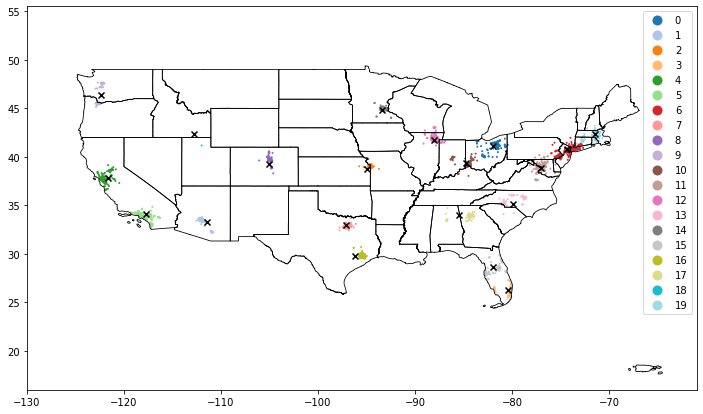

In [368]:
color_mapping = {0: "pink", 1: "green", 2: "red", 3: "blue", 4: "orange", 5: "cyan", 6: "magenta" }
fig = plt.figure(1, figsize=(12,9)) 
ax = fig.add_subplot()

# US Lower 48 Bounding Box
# -141.00000, 26.00000, -65.50000, 72.00000

ax.set_xlim(-130, -61)
ax.set_ylim(16, 55.5)
usa.boundary.plot(ax=ax, color='black', linewidth=.8)
#gdf.plot(ax=ax, color=gdf['cluster_kmeans'].map(color_mapping), markersize=1)
gdf[gdf["distance_kmeans"]<150000].plot(ax=ax, markersize=1, column="cluster_kmeans", cmap='tab20', categorical=True, legend=True)
#gdf.plot(ax=ax, markersize=5, column="cluster_kmeans", cmap='tab20', categorical=True, legend=True)
#plt.scatter(X['longitude'], X['latitude'], c=gdf['cluster_kmeans'], cmap='tab10')
plt.scatter(x, y, color="black", marker="x")
fig.savefig('../plots/kmeans_25_min_150.png')
plt.show()

## DBSCAN

In [341]:
from sklearn.cluster import DBSCAN


In [342]:
dbscan = DBSCAN(eps=2,min_samples=10).fit(X)
gdf['cluster_DBSCAN'] = dbscan.labels_

In [343]:
np.unique(dbscan.labels_)

array([-1,  0,  1,  2,  3,  4,  5,  6,  7])

In [344]:
dbscan.components_


array([[ -85.48732833,   32.60681297],
       [ -86.80275567,   33.5097215 ],
       [ -86.64743685,   33.59558141],
       ...,
       [ -87.92104783,   42.56589181],
       [ -88.04822244,   43.06772322],
       [-104.80569895,   41.16071801]])

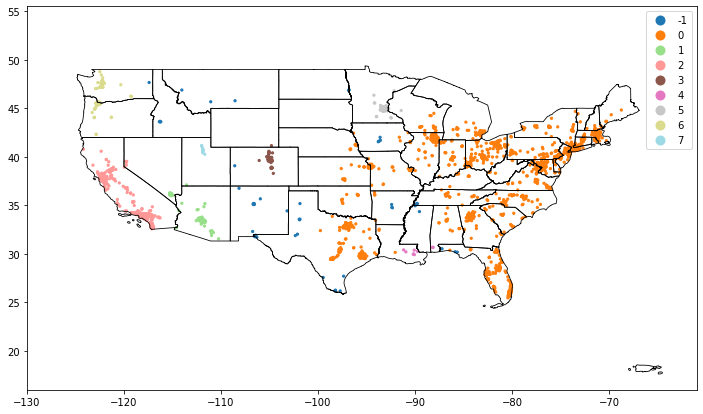

In [363]:
color_mapping = {0: "pink", 1: "green", 2: "red", 3: "blue", 4: "orange", 5: "cyan", 6: "navy", 7: "black", -1: "magenta" }
fig = plt.figure(1, figsize=(12,9)) 
ax = fig.add_subplot()

# US Lower 48 Bounding Box
# -141.00000, 26.00000, -65.50000, 72.00000

ax.set_xlim(-130, -61)
ax.set_ylim(16, 55.5)
usa.boundary.plot(ax=ax, color='black', linewidth=.8)
gdf.plot(ax=ax, markersize=5, column="cluster_DBSCAN", cmap='tab20', categorical=True, legend=True)
#plt.scatter(x, y, color="black", marker="x")
fig.savefig('../plots/dbscan.png')
plt.show()

## OPTICS

In [346]:
from sklearn.cluster import OPTICS

In [365]:
optics = OPTICS(min_samples=50).fit(X)

In [348]:
np.unique(optics.labels_)


array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8])

In [366]:
gdf['cluster_OPTICS'] = optics.labels_

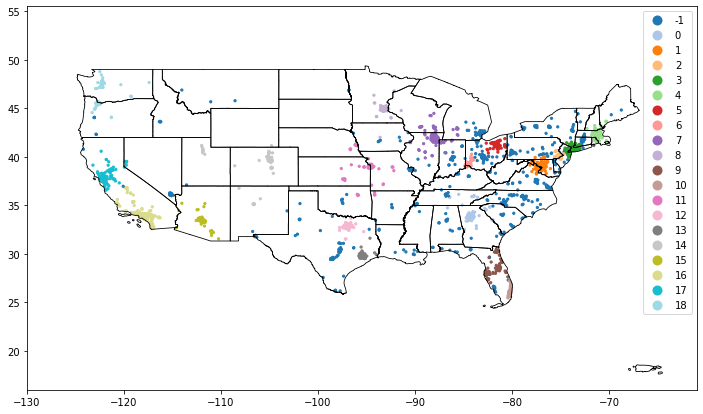

In [367]:
fig = plt.figure(1, figsize=(12,9)) 
ax = fig.add_subplot()

ax.set_xlim(-130, -61)
ax.set_ylim(16, 55.5)
usa.boundary.plot(ax=ax, color='black', linewidth=.8)
gdf.plot(ax=ax, markersize=5, column="cluster_OPTICS", cmap='tab20', categorical=True, legend=True)
#plt.scatter(x, y, color="black", marker="x")
fig.savefig('../plots/optics.png')
plt.show()